In [1]:
#Refernce Link for Chennai Dataset
#https://www.kaggle.com/datasets/phiitm/chennai-zomato-restaurants-data

In [ ]:
#Import The Libraries

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.io as pio

In [3]:
#2.Arrange the Dataset in dataframe

In [4]:
data_df=pd.read_csv("Zomato Chennai Listing.csv")
data_df.head()

,Zomato URL,Name of Restaurant,Address,Location,Cuisine,Top Dishes,Price for 2,Dining Rating,Dining Rating Count,Delivery Rating,Delivery Rating Count,Features
0,https://www.zomato.com/chennai/yaa-mohaideen-b...,Yaa Mohaideen Briyani,"336 & 338, Main Road, Pallavaram, Chennai",Pallavaram,['Biryani'],"['Bread Halwa', ' Chicken 65', ' Mutton Biryan...",500.0,4.3,1500,4.3,9306,"['Home Delivery', 'Indoor Seating']"
1,https://www.zomato.com/chennai/sukkubhai-biriy...,Sukkubhai Biriyani,"New 14, Old 11/3Q, Railway Station Road, MKN ...",Alandur,"['Biryani', ' North Indian', ' Mughlai', ' Des...","['Beef Biryani', ' Beef Fry', ' Paratha', ' Pa...",1000.0,4.4,3059,4.1,39200,"['Home Delivery', 'Free Parking', 'Table booki..."
2,https://www.zomato.com/chennai/ss-hyderabad-bi...,SS Hyderabad Biryani,"98/339, Arcot Road, Opposite Gokulam Chit Fun...",Kodambakkam,"['Biryani', ' North Indian', ' Chinese', ' Ara...","['Brinjal Curry', ' Tandoori Chicken', ' Chick...",500.0,4.3,1361,4.4,10500,"['Home Delivery', 'Indoor Seating']"
3,https://www.zomato.com/chennai/kfc-perambur,KFC,"10, Periyar Nagar, 70 Feet Road, Near Sheeba ...",Perambur,"['Burger', ' Fast Food', ' Finger Food', ' Bev...",['Zinger Burger'],500.0,4.0,1101,4.0,11200,"['Home Delivery', 'Free Parking', 'Card Upon D..."
4,https://www.zomato.com/chennai/tasty-kitchen-p...,Tasty Kitchen,"135B, SRP Colony, Peravallur, Near Perambur, ...",Perambur,"['Chinese', ' Biryani', ' North Indian', ' Che...","['Mutton Biryani', ' Chicken Rice', ' Tomato R...",450.0,4.2,617,4.1,22400,"['Home Delivery', 'Indoor Seating']"


In [5]:
#3.Getting Basic Information about the Dataset

In [6]:
data_df.shape

(12032, 12)

In [7]:
data_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12032 entries, 0 to 12031
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Zomato URL             12032 non-null  object 
 1   Name of Restaurant     12032 non-null  object 
 2   Address                12032 non-null  object 
 3   Location               12032 non-null  object 
 4   Cuisine                12032 non-null  object 
 5   Top Dishes             12032 non-null  object 
 6   Price for 2            12032 non-null  float64
 7   Dining Rating          6681 non-null   float64
 8   Dining Rating Count    11812 non-null  object 
 9   Delivery Rating        6181 non-null   float64
 10  Delivery Rating Count  11812 non-null  object 
 11  Features               12032 non-null  object 
dtypes: float64(3), object(9)
memory usage: 1.1+ MB


In [8]:
data_df.describe()

,Price for 2,Dining Rating,Delivery Rating
count,12032.000000,6681.000000,6181.000000
mean,397.611370,3.387756,3.805290
std,332.045938,0.558181,0.374213
min,40.000000,0.300000,0.300000
25%,200.000000,3.100000,3.600000
50%,300.000000,3.500000,3.900000
75%,450.000000,3.800000,4.000000
max,5000.000000,4.900000,4.700000


In [9]:
# 4. Cleaning the Dataset

In [10]:
#A.Removing the redundunt rows of data

In [11]:
# Checking redundunt rows of data
wrong_data=data_df['Address']=='Address'
data_df[wrong_data]

,Zomato URL,Name of Restaurant,Address,Location,Cuisine,Top Dishes,Price for 2,Dining Rating,Dining Rating Count,Delivery Rating,Delivery Rating Count,Features


In [12]:
#  Performing Negation of the wrong dataset and then storing the correct data back in the raw_df DataFrame
#  This permamnently remove the wrong data from the original dataframe
data_df=data_df[~wrong_data]

In [13]:
# Dropping columns which are not required for further analysis
data_df.drop(['Zomato URL','Address'],axis=1,inplace=True)

In [14]:
data_df.head()

,Name of Restaurant,Location,Cuisine,Top Dishes,Price for 2,Dining Rating,Dining Rating Count,Delivery Rating,Delivery Rating Count,Features
0,Yaa Mohaideen Briyani,Pallavaram,['Biryani'],"['Bread Halwa', ' Chicken 65', ' Mutton Biryan...",500.0,4.3,1500,4.3,9306,"['Home Delivery', 'Indoor Seating']"
1,Sukkubhai Biriyani,Alandur,"['Biryani', ' North Indian', ' Mughlai', ' Des...","['Beef Biryani', ' Beef Fry', ' Paratha', ' Pa...",1000.0,4.4,3059,4.1,39200,"['Home Delivery', 'Free Parking', 'Table booki..."
2,SS Hyderabad Biryani,Kodambakkam,"['Biryani', ' North Indian', ' Chinese', ' Ara...","['Brinjal Curry', ' Tandoori Chicken', ' Chick...",500.0,4.3,1361,4.4,10500,"['Home Delivery', 'Indoor Seating']"
3,KFC,Perambur,"['Burger', ' Fast Food', ' Finger Food', ' Bev...",['Zinger Burger'],500.0,4.0,1101,4.0,11200,"['Home Delivery', 'Free Parking', 'Card Upon D..."
4,Tasty Kitchen,Perambur,"['Chinese', ' Biryani', ' North Indian', ' Che...","['Mutton Biryani', ' Chicken Rice', ' Tomato R...",450.0,4.2,617,4.1,22400,"['Home Delivery', 'Indoor Seating']"


In [15]:
#B.Removing the Null Records

In [16]:
data_df.isnull().sum()

Name of Restaurant          0
Location                    0
Cuisine                     0
Top Dishes                  0
Price for 2                 0
Dining Rating            5351
Dining Rating Count       220
Delivery Rating          5851
Delivery Rating Count     220
Features                    0
dtype: int64

In [17]:
# Checking for a null row
data_df[data_df['Price for 2'].isnull()]
data_df

,Name of Restaurant,Location,Cuisine,Top Dishes,Price for 2,Dining Rating,Dining Rating Count,Delivery Rating,Delivery Rating Count,Features
0,Yaa Mohaideen Briyani,Pallavaram,['Biryani'],"['Bread Halwa', ' Chicken 65', ' Mutton Biryan...",500.0,4.3,1500,4.3,9306,"['Home Delivery', 'Indoor Seating']"
1,Sukkubhai Biriyani,Alandur,"['Biryani', ' North Indian', ' Mughlai', ' Des...","['Beef Biryani', ' Beef Fry', ' Paratha', ' Pa...",1000.0,4.4,3059,4.1,39200,"['Home Delivery', 'Free Parking', 'Table booki..."
2,SS Hyderabad Biryani,Kodambakkam,"['Biryani', ' North Indian', ' Chinese', ' Ara...","['Brinjal Curry', ' Tandoori Chicken', ' Chick...",500.0,4.3,1361,4.4,10500,"['Home Delivery', 'Indoor Seating']"
3,KFC,Perambur,"['Burger', ' Fast Food', ' Finger Food', ' Bev...",['Zinger Burger'],500.0,4.0,1101,4.0,11200,"['Home Delivery', 'Free Parking', 'Card Upon D..."
4,Tasty Kitchen,Perambur,"['Chinese', ' Biryani', ' North Indian', ' Che...","['Mutton Biryani', ' Chicken Rice', ' Tomato R...",450.0,4.2,617,4.1,22400,"['Home Delivery', 'Indoor Seating']"
...,...,...,...,...,...,...,...,...,...,...
12027,CK's Sandwiches,Porur,['Sandwich'],Invalid,350.0,NaN,NaN,NaN,NaN,"['Breakfast', 'Delivery Only']"
12028,CK's Sandwiches,Kolathur,['Sandwich'],Invalid,350.0,NaN,NaN,NaN,NaN,"['Breakfast', 'Delivery Only']"
12029,CK's Sandwiches,Anna Nagar East,['Sandwich'],Invalid,350.0,NaN,NaN,NaN,NaN,"['Breakfast', 'Delivery Only']"
12030,CK's Sandwiches,Ramapuram,['Sandwich'],Invalid,350.0,NaN,NaN,NaN,NaN,"['Breakfast', 'Delivery Only']"


In [18]:
# Removing the bracket character from columns         (regex changed to flags)
data_df['Features'] = data_df['Features'].str.replace(']', '', regex=True)
data_df['Cuisine'] = data_df['Cuisine'].str.replace(']', '', regex=True)
data_df['Top Dishes'] = data_df['Top Dishes'].str.replace(']', '', regex=True)
data_df.head()

,Name of Restaurant,Location,Cuisine,Top Dishes,Price for 2,Dining Rating,Dining Rating Count,Delivery Rating,Delivery Rating Count,Features
0,Yaa Mohaideen Briyani,Pallavaram,['Biryani',"['Bread Halwa', ' Chicken 65', ' Mutton Biryan...",500.0,4.3,1500,4.3,9306,"['Home Delivery', 'Indoor Seating'"
1,Sukkubhai Biriyani,Alandur,"['Biryani', ' North Indian', ' Mughlai', ' Des...","['Beef Biryani', ' Beef Fry', ' Paratha', ' Pa...",1000.0,4.4,3059,4.1,39200,"['Home Delivery', 'Free Parking', 'Table booki..."
2,SS Hyderabad Biryani,Kodambakkam,"['Biryani', ' North Indian', ' Chinese', ' Ara...","['Brinjal Curry', ' Tandoori Chicken', ' Chick...",500.0,4.3,1361,4.4,10500,"['Home Delivery', 'Indoor Seating'"
3,KFC,Perambur,"['Burger', ' Fast Food', ' Finger Food', ' Bev...",['Zinger Burger',500.0,4.0,1101,4.0,11200,"['Home Delivery', 'Free Parking', 'Card Upon D..."
4,Tasty Kitchen,Perambur,"['Chinese', ' Biryani', ' North Indian', ' Che...","['Mutton Biryani', ' Chicken Rice', ' Tomato R...",450.0,4.2,617,4.1,22400,"['Home Delivery', 'Indoor Seating'"


In [19]:
# Replace 'None' values with 0 in the entire DataFrame
data_df.replace('None', 0, inplace=True)
data_df

,Name of Restaurant,Location,Cuisine,Top Dishes,Price for 2,Dining Rating,Dining Rating Count,Delivery Rating,Delivery Rating Count,Features
0,Yaa Mohaideen Briyani,Pallavaram,['Biryani',"['Bread Halwa', ' Chicken 65', ' Mutton Biryan...",500.0,4.3,1500,4.3,9306,"['Home Delivery', 'Indoor Seating'"
1,Sukkubhai Biriyani,Alandur,"['Biryani', ' North Indian', ' Mughlai', ' Des...","['Beef Biryani', ' Beef Fry', ' Paratha', ' Pa...",1000.0,4.4,3059,4.1,39200,"['Home Delivery', 'Free Parking', 'Table booki..."
2,SS Hyderabad Biryani,Kodambakkam,"['Biryani', ' North Indian', ' Chinese', ' Ara...","['Brinjal Curry', ' Tandoori Chicken', ' Chick...",500.0,4.3,1361,4.4,10500,"['Home Delivery', 'Indoor Seating'"
3,KFC,Perambur,"['Burger', ' Fast Food', ' Finger Food', ' Bev...",['Zinger Burger',500.0,4.0,1101,4.0,11200,"['Home Delivery', 'Free Parking', 'Card Upon D..."
4,Tasty Kitchen,Perambur,"['Chinese', ' Biryani', ' North Indian', ' Che...","['Mutton Biryani', ' Chicken Rice', ' Tomato R...",450.0,4.2,617,4.1,22400,"['Home Delivery', 'Indoor Seating'"
...,...,...,...,...,...,...,...,...,...,...
12027,CK's Sandwiches,Porur,['Sandwich',Invalid,350.0,NaN,NaN,NaN,NaN,"['Breakfast', 'Delivery Only'"
12028,CK's Sandwiches,Kolathur,['Sandwich',Invalid,350.0,NaN,NaN,NaN,NaN,"['Breakfast', 'Delivery Only'"
12029,CK's Sandwiches,Anna Nagar East,['Sandwich',Invalid,350.0,NaN,NaN,NaN,NaN,"['Breakfast', 'Delivery Only'"
12030,CK's Sandwiches,Ramapuram,['Sandwich',Invalid,350.0,NaN,NaN,NaN,NaN,"['Breakfast', 'Delivery Only'"


In [20]:
#Working on 'Location' Column

In [21]:
pd.set_option('display.max_rows', None)

In [22]:
data_df['Location'].value_counts()

Location
Porur                                                       418
Velachery                                                   372
Ambattur                                                    334
T. Nagar                                                    315
Perungudi                                                   288
Anna Nagar East                                             285
Perambur                                                    275
Medavakkam                                                  271
Tambaram                                                    258
Ramapuram                                                   248
Nungambakkam                                                248
Anna Nagar West                                             239
Thuraipakkam                                                237
Mogappair                                                   218
Selaiyur                                                    218
Kilpauk                        

In [23]:
# Removing the irrelevant text from the Location column
data_df['Location']=data_df['Location'].str.replace('[a-zA-Z].+-- ','',regex=True)

In [24]:
# Replacing Small regions with Known region name
data_df['Location'] = data_df['Location'].str.replace('Phoenix Market City|The Grand Mall','Velachery',regex=True)
data_df['Location'] = data_df['Location'].str.replace('OMR Food Street|Kandanchavadi|Navallur|Injambakkam','Guduvancheri',regex=True)
data_df['Location'] = data_df['Location'].str.replace('Ascendas IT Park','Taramani',regex=True)
data_df['Location'] = data_df['Location'].str.replace('Keys Hotel','Thiruvanmiyur',regex=True)
data_df['Location'] = data_df['Location'].str.replace('Jade Resorts','East Coast Road (ECR)',regex=True)
data_df['Location'] = data_df['Location'].str.replace('Novotel Chennai|IBIS Hotel|Days Hotel|Southern Residency Hotel','OMR',regex=True)
data_df['Location'] = data_df['Location'].str.replace('Hotel Blue Diamond','Kilpauk',regex=True)
data_df['Location'] = data_df['Location'].str.replace('Chandra Metro Mall','Virugambakkam',regex=True)
data_df['Location'] = data_df['Location'].str.replace('Forum Vijaya Mall|Hotel Maurya International','Vadapalani',regex=True)
data_df['Location'] = data_df['Location'].str.replace('Express Avenue Mall|E Hotel|Deccan Plaza','Royapettah',regex=True)
data_df['Location'] = data_df['Location'].str.replace('Mahindra World City','Chengalpattu',regex=True)
data_df['Location'] = data_df['Location'].str.replace('Ambit IT Park|OMR Food Street|Eat And Pack','Ambattur',regex=True)
data_df['Location'] = data_df['Location'].str.replace('Chennai Citi Centre','Mylapore',regex=True)
data_df['Location'] = data_df['Location'].str.replace('Ampa Skywalk Mall','Aminijikarai',regex=True)
data_df['Location'] = data_df['Location'].str.replace('Hyatt Regency|The Raintree','Teynampet',regex=True)
data_df['Location'] = data_df['Location'].str.replace('Kora Food Street','Anna Nagar West',regex=True)
data_df['Location'] = data_df['Location'].str.replace('The Park|Ispahani Centre|Taj Coromandel|Hotel Park Elanza|The Spring Hotel|Hotel Goutham Manor','Nungambakkam',regex=True)
data_df['Location'] = data_df['Location'].str.replace('Mamalla Beach Resort','Mahabalipuram',regex=True)
data_df['Location'] = data_df['Location'].str.replace('Hotel Peninsula|GLM Meridian Hotel|Hotel NRS Sakithyan','T. Nagar',regex=True)
data_df['Location'] = data_df['Location'].str.replace('Fairfield by Marriot','Chengalpattu',regex=True)
data_df['Location'] = data_df['Location'].str.replace('Park Plaza OMR','Thuraipakkam',regex=True)
data_df['Location'] = data_df['Location'].str.replace('Massbunk Complex','Purasavakkam',regex=True)
data_df['Location'] = data_df['Location'].str.replace('The Hotel Royal Plaza','Koyambedu ',regex=True)
data_df['Location'] = data_df['Location'].str.replace('Hilton Chennai|Lemon Tree Hotel|Hablis Hotel|Ramada plaza','Guindy',regex=True)

In [25]:
#Removing Duplicate records

In [26]:
pd.set_option('display.max_rows', None)

In [27]:
data_df['Location'].value_counts()

Location
Porur                                                       418
Velachery                                                   372
Ambattur                                                    334
T. Nagar                                                    315
Perungudi                                                   288
Anna Nagar East                                             285
Perambur                                                    275
Medavakkam                                                  271
Tambaram                                                    258
Nungambakkam                                                248
Ramapuram                                                   248
Anna Nagar West                                             239
Thuraipakkam                                                237
Mogappair                                                   218
Selaiyur                                                    218
Kilpauk                        

In [28]:
# Finding all the duplicate rows
data_df[data_df.duplicated()]

,Name of Restaurant,Location,Cuisine,Top Dishes,Price for 2,Dining Rating,Dining Rating Count,Delivery Rating,Delivery Rating Count,Features
9103,Brownie Heaven,T. Nagar,"['Bakery', ' Desserts', ' Beverages'",Invalid,350.0,NaN,Not enough Dining Reviews,NaN,Not enough Delivery Reviews,"['Home Delivery', 'Indoor Seating', 'Desserts ..."
9995,ibaco,Kanchipuram District,['Ice Cream',Invalid,200.0,NaN,Not enough Dining Reviews,NaN,Not enough Delivery Reviews,"['Home Delivery', 'Vegetarian Only', 'Indoor S..."
10534,Cake Waves,Thiruvallur,"['Bakery', ' Fast Food'",Invalid,500.0,NaN,Not enough Dining Reviews,NaN,Not enough Delivery Reviews,"['Home Delivery', 'Indoor Seating', 'Desserts ..."
11225,Pizza Square,Thiruvanmiyur,"['Pizza', ' Fast Food'",Invalid,300.0,NaN,Not enough Dining Reviews,NaN,Not enough Delivery Reviews,"['Home Delivery', 'Indoor Seating'"
11361,Aavin Parlour,George Town,['Ice Cream',Invalid,200.0,NaN,Not enough Dining Reviews,NaN,Does not offer Delivery,"['Takeaway Only', 'Desserts and Bakes'"
11390,The Cake Point,Mogappair,['Bakery',Invalid,200.0,NaN,Not enough Dining Reviews,NaN,Not enough Delivery Reviews,"['Home Delivery', 'Indoor Seating', 'Desserts ..."
11489,Parantha Pundit,Mogappair,"['North Indian', ' Beverages'",Invalid,200.0,NaN,Does not offer Dining,NaN,Not enough Delivery Reviews,['Delivery Only'
11496,Parantha Pundit,Kovalam,"['North Indian', ' Beverages'",Invalid,200.0,NaN,Does not offer Dining,NaN,Not enough Delivery Reviews,['Delivery Only'
11553,Leo Coffee,Mylapore,"['Coffee', ' Tea', ' Beverages'",Invalid,250.0,NaN,Does not offer Dining,NaN,Not enough Delivery Reviews,['Home Delivery'
11572,Leo Coffee,Anna Nagar East,"['Coffee', ' Tea', ' Beverages'",Invalid,250.0,NaN,Not enough Dining Reviews,NaN,Does not offer Delivery,"['Takeaway Only', 'Vegetarian Only'"


In [29]:
# Dropping all the duplicate rows
data_df=data_df.drop_duplicates()

In [30]:
#Copying the cleaned data into a new DataFrame

In [31]:
zomato_df=data_df.copy()

In [32]:
zomato_df.head()

,Name of Restaurant,Location,Cuisine,Top Dishes,Price for 2,Dining Rating,Dining Rating Count,Delivery Rating,Delivery Rating Count,Features
0,Yaa Mohaideen Briyani,Pallavaram,['Biryani',"['Bread Halwa', ' Chicken 65', ' Mutton Biryan...",500.0,4.3,1500,4.3,9306,"['Home Delivery', 'Indoor Seating'"
1,Sukkubhai Biriyani,Alandur,"['Biryani', ' North Indian', ' Mughlai', ' Des...","['Beef Biryani', ' Beef Fry', ' Paratha', ' Pa...",1000.0,4.4,3059,4.1,39200,"['Home Delivery', 'Free Parking', 'Table booki..."
2,SS Hyderabad Biryani,Kodambakkam,"['Biryani', ' North Indian', ' Chinese', ' Ara...","['Brinjal Curry', ' Tandoori Chicken', ' Chick...",500.0,4.3,1361,4.4,10500,"['Home Delivery', 'Indoor Seating'"
3,KFC,Perambur,"['Burger', ' Fast Food', ' Finger Food', ' Bev...",['Zinger Burger',500.0,4.0,1101,4.0,11200,"['Home Delivery', 'Free Parking', 'Card Upon D..."
4,Tasty Kitchen,Perambur,"['Chinese', ' Biryani', ' North Indian', ' Che...","['Mutton Biryani', ' Chicken Rice', ' Tomato R...",450.0,4.2,617,4.1,22400,"['Home Delivery', 'Indoor Seating'"


In [33]:
#Performing Exploratory Data Analysis
#Q1) How many restaurants are in Chennai for each type of cuisine?

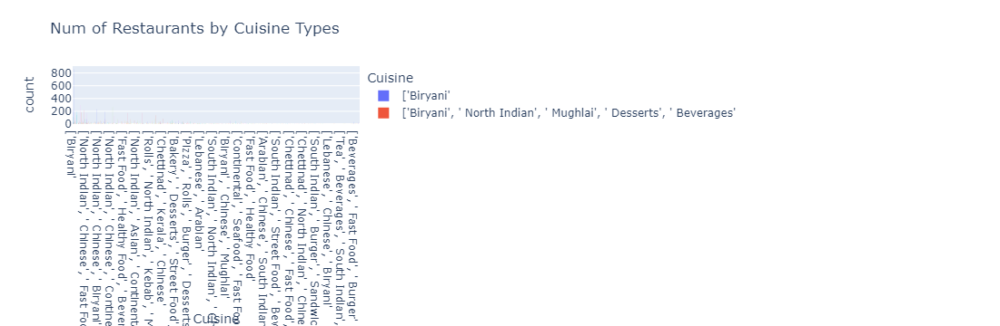

In [34]:
import plotly.express as px

fig = px.histogram(zomato_df, x='Cuisine', color='Cuisine', title='Num of Restaurants by Cuisine Types', 
                   labels={'Cuisine': 'Cuisine'})
fig.show()

In [35]:
#Q2) What are the percentage of restaurants by Rating Type in Chennai?

In [36]:
rating_type_df=zomato_df['Dining Rating'].value_counts().reset_index()
rating_type_df.rename(columns={'index':'Dining Rating','Dining Rating':'COUNT OF RESTAURANTS'},inplace=True)
rating_type_df

,COUNT OF RESTAURANTS,count
0,3.6,584
1,3.5,553
2,3.7,525
3,3.4,500
4,3.3,463
5,3.8,460
6,3.2,433
7,3.9,379
8,3.1,363
9,2.0,354


In [44]:
#Q3) Which is the best Restaurant in Chennai?

In [45]:
restaurant_df=zomato_df[zomato_df['Name of Restaurant']=='Yaa Mohaideen Biryani']
restaurant_df.sort_values(by='Dining Rating Count',ascending=False).head(5)

,Name of Restaurant,Location,Cuisine,Top Dishes,Price for 2,Dining Rating,Dining Rating Count,Delivery Rating,Delivery Rating Count,Features
8762,Yaa Mohaideen Biryani,Egatoor,"['Biryani', ' North Indian'","['Bread Halwa', ' Mutton Biryani'",450.0,NaN,Does not offer Dining,4.0,7308,['Home Delivery'
8769,Yaa Mohaideen Biryani,Karapakkam,['Biryani',Invalid,600.0,NaN,Does not offer Dining,3.3,161,['Delivery Only'
8770,Yaa Mohaideen Biryani,Chengalpattu,"['Biryani', ' Chinese', ' Tamil'",Invalid,600.0,NaN,Does not offer Dining,3.5,527,['Home Delivery'
8761,Yaa Mohaideen Biryani,Ambattur,"['Biryani', ' Chettinad', ' North Indian', ' M...",['Biryani',700.0,3.7,96,4.0,3511,"['Home Delivery', 'Indoor Seating'"
8763,Yaa Mohaideen Biryani,Velachery,"['Chinese', ' Biryani', ' North Indian'",Invalid,600.0,3.6,95,3.9,1631,"['Breakfast', 'Home Delivery', 'Indoor Seating'"


In [46]:
#Q4) Which places have the highest rated restaurant for each Cuisine Type in Chennai?

In [47]:
zomato_df['Dining Rating'] = pd.to_numeric(zomato_df['Dining Rating'], errors='coerce')

In [48]:
# Assuming restaurants having rating above 4.5
highest_rated_df=zomato_df[zomato_df['Dining Rating']>=4.5]
highest_rated_df

,Name of Restaurant,Location,Cuisine,Top Dishes,Price for 2,Dining Rating,Dining Rating Count,Delivery Rating,Delivery Rating Count,Features
15,Welcome Hotel,Purasavakkam,"['South Indian', ' Desserts', ' Beverages'","['Pongal', ' Podi Dosa', ' Idli Sambar', ' Vad...",300.0,4.5,1094,NaN,Does not offer Delivery,"['Breakfast', 'Vegetarian Only', 'Indoor Seating'"
24,Eating Circles,Alwarpet,['South Indian',"['Rose Milk', ' Neer Dosa', ' Thatte Idli', ' ...",250.0,4.7,782,4.2,2744,"['Breakfast', 'Home Delivery', 'Vegetarian Onl..."
37,Shree Mithai,Chetpet,"['Mithai', ' Street Food', ' Fast Food'","['Chaat', ' Badam Milk', ' Pav Bhaji', ' Panip...",300.0,4.6,1085,4.4,18600,"['Breakfast', 'Home Delivery', 'Vegetarian Onl..."
50,Andhikkadai,Velachery,['South Indian',"['Coffee', ' Sweet Kozhukattai', ' Idli', ' Po...",200.0,4.6,908,4.2,17300,"['Breakfast', 'Home Delivery', 'Vegetarian Onl..."
57,Brownie Heaven,Royapettah,"['Bakery', ' Desserts', ' Beverages'","['Vanilla Ice Cream', ' Brownie Shake', ' Filt...",350.0,4.9,842,4.3,2270,"['Home Delivery', 'Indoor Seating', 'Desserts ..."
59,Mezze,Alwarpet,['Middle Eastern',"['Baklava', ' Mezze', ' Shawarma', ' Pita Brea...",700.0,4.7,1152,4.2,2249,"['Home Delivery', 'Indoor Seating'"
62,Amadora Gourmet Ice Cream & Sorbet,Nungambakkam,"['Desserts', ' Ice Cream'","['Sandwich', ' Gelato', ' Chocolate Icecreams'...",500.0,4.8,1516,4.5,361,"['Home Delivery', 'Outdoor Seating', 'Desserts..."
67,Pumpkin Tales,Alwarpet,"['Singaporean', ' American', ' European', ' Co...","['Pumpkin Soup', ' Bibimbap', ' Noodle', ' Che...",1800.0,4.5,768,4.0,245,"['Breakfast', 'Home Delivery', 'Indoor Seating..."
68,Sandy's Chocolate Laboratory,Nungambakkam,"['Cafe', ' Continental', ' Italian', ' Desserts'","['Tiny Chocolate Cake', ' Hot Chocolate', ' Sa...",1400.0,4.5,2252,4.3,1973,"['Breakfast', 'Home Delivery', 'Free Parking',..."
70,Little Italy,Besant Nagar,"['Italian', ' Mexican', ' Salad'","['Pasta', ' Pizza', ' Nachos', ' Tiramisu', ' ...",1500.0,4.7,1349,4.2,1435,"['Home Delivery', 'Vegetarian Only', 'Valet Pa..."


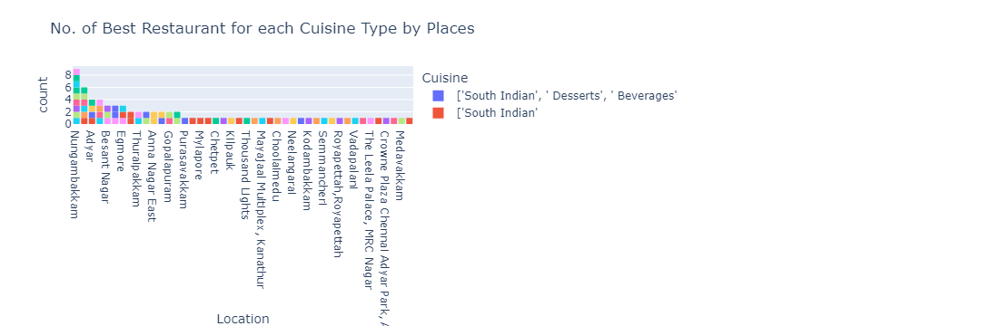

In [49]:
fig = px.histogram(highest_rated_df, x='Location', color='Cuisine',
                   
                 title= 'No. of Best Restaurant for each Cuisine Type by Places').update_xaxes(categoryorder="total descending")
fig.show()

In [50]:
#Q5) What is the Avg Price Distibution of highest rated restaurant for each feature type in Chennai?

In [51]:
highest_rated_price_df=highest_rated_df.groupby(by=['Location','Features'])['Price for 2'].mean().reset_index()
highest_rated_price_df

,Location,Features,Price for 2
0,Adyar,"['Home Delivery', 'Free Parking', 'Outdoor Sea...",200.0
1,Adyar,"['Home Delivery', 'Vegetarian Only', 'Indoor S...",500.0
2,Adyar,"['Home Delivery', 'Wheelchair Accessible', 'Ve...",800.0
3,Adyar,"['Home Delivery', 'Wheelchair Accessible', 'Ve...",1800.0
4,Alwarpet,"['Breakfast', 'Home Delivery', 'Indoor Seating...",1800.0
5,Alwarpet,"['Breakfast', 'Home Delivery', 'Vegetarian Onl...",250.0
6,Alwarpet,"['Home Delivery', 'Indoor Seating'",425.0
7,Alwarpet,"['Home Delivery', 'Table booking recommended',...",2000.0
8,Alwarpet,"['Home Delivery', 'Vegetarian Only', 'Sugar Fr...",350.0
9,Anna Nagar East,"['Home Delivery', 'Indoor Seating', 'Table boo...",1000.0


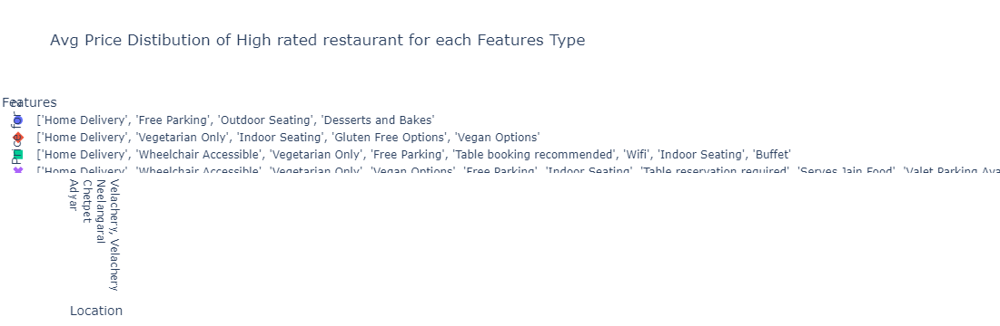

In [52]:
fig = px.scatter(highest_rated_price_df, x="Location", y="Price for 2", color="Features", symbol="Features",
                  title=' Avg Price Distibution of High rated restaurant for each Features Type').update_traces(marker_size=10)
fig.show()

In [53]:
#Q6) Which areas have a large number of Chinese Restaurant Market?

In [54]:
chinese_df=zomato_df[zomato_df['Cuisine'].str.contains('Chinese')]
chinese_df

,Name of Restaurant,Location,Cuisine,Top Dishes,Price for 2,Dining Rating,Dining Rating Count,Delivery Rating,Delivery Rating Count,Features
2,SS Hyderabad Biryani,Kodambakkam,"['Biryani', ' North Indian', ' Chinese', ' Ara...","['Brinjal Curry', ' Tandoori Chicken', ' Chick...",500.0,4.3,1361,4.4,10500,"['Home Delivery', 'Indoor Seating'"
4,Tasty Kitchen,Perambur,"['Chinese', ' Biryani', ' North Indian', ' Che...","['Mutton Biryani', ' Chicken Rice', ' Tomato R...",450.0,4.2,617,4.1,22400,"['Home Delivery', 'Indoor Seating'"
5,Dine N Fun,Medavakkam,"['South Indian', ' North Indian', ' Chinese'","['Chicken Grill', ' Shawarma', ' Naan', ' Chic...",450.0,4.1,567,3.8,24700,"['Home Delivery', 'Indoor Seating'"
8,Savoury Sea Shell,Anna Nagar East,"['Arabian', ' Chinese', ' North Indian', ' Leb...","['Shawarma', ' Chicken Grill', ' Brownie', ' S...",1400.0,4.2,2564,4.1,21700,"['Home Delivery', 'Indoor Seating', 'Card Upon..."
9,Sangeetha Veg Restaurant,T. Nagar,"['South Indian', ' North Indian', ' Chinese', ...","['Filtered Coffee', ' Chaat', ' Faluda', ' Mas...",800.0,4.4,1578,4.2,39600,"['Breakfast', 'Home Delivery', 'Vegetarian Onl..."
12,Hotel Al Buhari,Vadapalani,"['Chinese', ' Chettinad'","['Shawarma', ' Fried Rice Chicken', ' Biryani'",350.0,4.0,982,3.8,22400,"['Home Delivery', 'Indoor Seating'"
13,Dindigul Thalappakatti,Porur,"['South Indian', ' Biryani', ' Chinese', ' Nor...","['Mutton Biryani', ' Faluda', ' Barbeque Chick...",900.0,4.3,770,4.0,7670,"['Home Delivery', 'Indoor Seating', 'Table res..."
14,Hotel Paramount,Kilpauk,"['North Indian', ' Chinese', ' Seafood', ' Sou...","['Biryani', ' Butter Chicken', ' Tandoori Chic...",500.0,4.3,1266,4.2,17700,"['Breakfast', 'Home Delivery', 'Indoor Seating..."
16,Arab Street,Ashok Nagar,"['Arabian', ' Biryani', ' Chinese', ' North In...","['Shawarma', ' Biryani', ' Chicken Grill', ' K...",800.0,4.1,1363,3.8,6228,"['Home Delivery', 'Valet Parking Available', '..."
17,Abid's,Chetpet,"['Seafood', ' Biryani', ' Hyderabadi', ' Arabi...","['Haleem', ' Hyderabadi Dum Biryani', ' Brinja...",1200.0,4.2,742,4.1,3020,"['Home Delivery', 'Valet Parking Available', '..."


In [55]:
chinese_rest_df=chinese_df.groupby(by='Location').agg({'Name of Restaurant':'count','Price for 2':'mean'}).rename(columns={'Name of Restaurant':'COUNT OF RESTAURANTS','PRICE':'Price for 2'})
chinese_rest_df=chinese_rest_df.sort_values('COUNT OF RESTAURANTS', ascending=False).head(25)
chinese_rest_df=chinese_rest_df.reset_index()
chinese_rest_df.head()

,Location,COUNT OF RESTAURANTS,Price for 2
0,Porur,131,409.541985
1,Ambattur,115,375.217391
2,Velachery,102,488.235294
3,Perambur,99,413.636364
4,Perungudi,93,445.698925


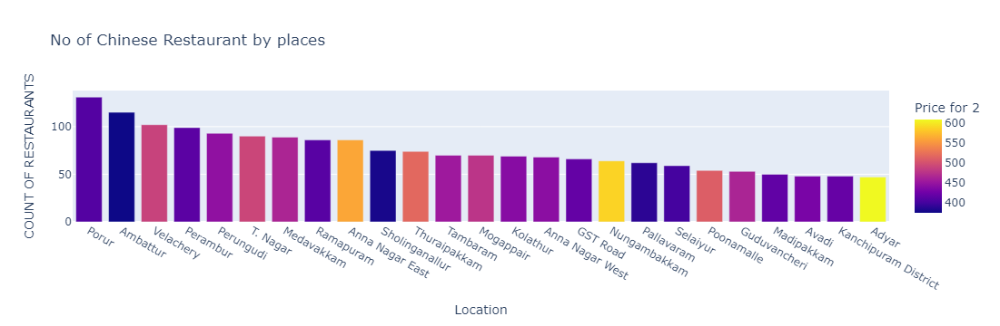

In [56]:
fig = px.bar(chinese_rest_df,x='Location',y='COUNT OF RESTAURANTS', color='Price for 2',title='No of Chinese Restaurant by places')
fig.show()

In [57]:
#Q7) Is there a relation between Price and Rating by each Cuisine Type?

In [58]:
price_rating_df=zomato_df.groupby(['Cuisine','Dining Rating'])['Price for 2'].mean().reset_index()
price_rating_df

,Cuisine,Dining Rating,Price for 2
0,"['American', ' Andhra', ' Asian', ' Beverages'...",2.4,800.000000
1,"['American', ' Continental'",4.1,1600.000000
2,"['American', ' Continental', ' European', ' It...",3.9,700.000000
3,"['American', ' Continental', ' Italian', ' Nor...",4.1,800.000000
4,"['American', ' Fast Food'",2.7,300.000000
5,"['American', ' Fast Food'",3.9,500.000000
6,"['American', ' Mexican', ' Fast Food'",0.3,250.000000
7,"['American', ' Mexican', ' Fast Food'",3.3,250.000000
8,"['American', ' Mexican', ' Steak', ' Beverages...",4.4,1600.000000
9,['Andhra',2.0,183.333333


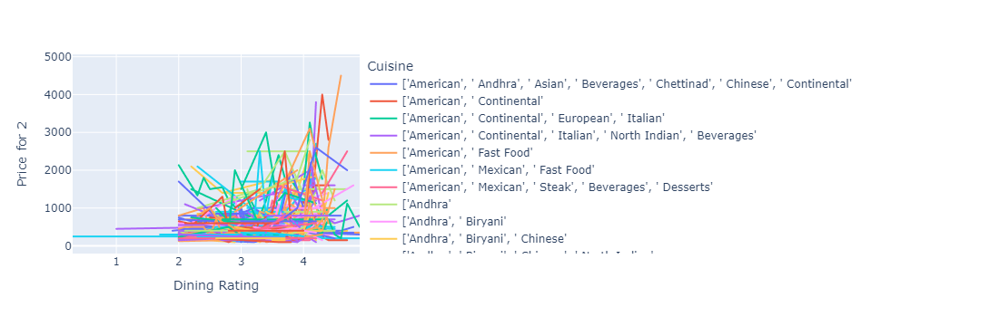

In [59]:
fig = px.line(price_rating_df, y="Price for 2", x="Dining Rating",color='Cuisine')
fig.show()

In [60]:
# Q8)Is there a relation between Location and Price?Q8)Is there a relation between Location and Price?Q8)Is there a relation between Location and Price?

In [61]:
region_price_df=zomato_df.groupby(['Location'])['Price for 2'].mean().reset_index()
region_price_df

,Location,Price for 2
0,InterContinental Chennai Mahabalipuram Resort...,1500.000000
1,Abhiramapuram,228.571429
2,"Abu Sarovar Portico, Egmore",1000.000000
3,Adambakkam,291.025641
4,Adyar,443.550000
5,Akkarai,703.333333
6,Alandur,352.857143
7,"Aloft Chennai, Sholinganallur",1750.000000
8,Alwarpet,501.724138
9,"Ambassador Pallava, Egmore",1333.333333


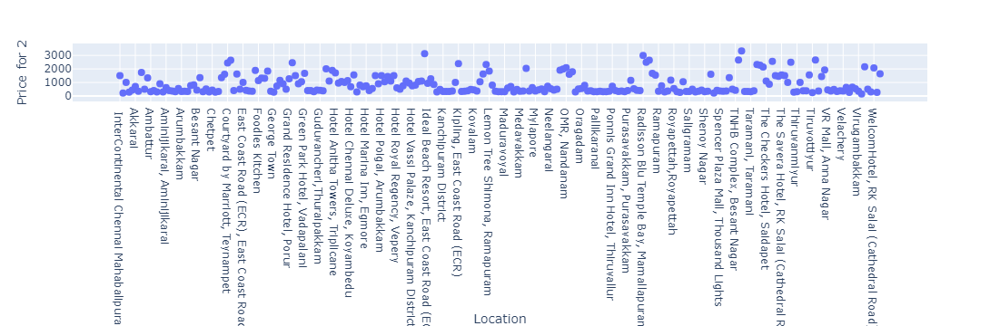

In [62]:
fig = px.scatter(region_price_df, x="Location", y="Price for 2").update_traces(marker_size=8)
fig.show()

In [63]:
#Q9) Find the list of Affordable Restaurants?

In [64]:
#the criteria for Affordable Restaurants would be:-
#1) Low Price 
#2) High Rated First step will be to find the restaurants with average cost 1/4th the average cost of most expensive restaurant in our dataframe. Let me explain:-The most expensive restaurant has an average meal cost= 6000.
#3) We'll try to stay economical and only pick the restaurants that are 1/4th of 6000.

In [65]:
max_price = zomato_df['Price for 2'].max()
one_fourth_price = max_price/4
one_fourth_price

1250.0

In [66]:
# Finding list of restaurants that have price less than and equal to 1/4th of the max price i.e Finding Cheap Restaurant
aff_rest_df = zomato_df[['Name of Restaurant','Price for 2','Cuisine','Location','Features']]
aff_rest_df = aff_rest_df[aff_rest_df['Price for 2'] <= 1250]
aff_rest_df.sort_values(by='Price for 2', inplace=True)
aff_rest_df

,Name of Restaurant,Price for 2,Cuisine,Location,Features
4685,Soda Hub,40.0,['Beverages',"Guduvancheri, Guduvancheri","['Takeaway Only', 'Vegetarian Only', 'Desserts..."
7405,Indian Coffee House,50.0,"['Beverages', ' Juices'",Vepery,['Takeaway Only'
6854,Planet Soda,50.0,"['Beverages', ' Juices'","Guduvancheri, Guduvancheri","['Desserts and Bakes', 'Outdoor Seating'"
8355,Kaafemaa,50.0,['Beverages',Ambattur,['Indoor Seating'
1448,Mamee Soup,60.0,['Healthy Food',West Mambalam,"['Vegetarian Only', 'Indoor Seating'"
5475,Muthu Tiffin Center,100.0,['South Indian',Adambakkam,"['Breakfast', 'Home Delivery', 'Vegetarian Onl..."
8405,Hotel Jamaliya,100.0,['South Indian',Purasavakkam,"['Breakfast', 'Vegetarian Only', 'Indoor Seating'"
8407,Safa Juice Park,100.0,"['Beverages', ' Juices'",Velachery,['Indoor Seating'
5513,New Bombay Chapati,100.0,['North Indian',K.K. Nagar,"['Home Delivery', 'Indoor Seating'"
8412,Chennai Juice World,100.0,['Juices',Vadapalani,['Takeaway Only'


In [67]:
# Finding the highest rated list of restaurants
highrate_rest_df = zomato_df[['Name of Restaurant','Price for 2','Cuisine','Location','Dining Rating','Features']]
highrate_rest_df = highrate_rest_df[highrate_rest_df['Dining Rating']>= 4.5]
#highrate_rest_df.sort_values(by='Rating', ascending=False, inplace=True)
highrate_rest_df.sort_values(by='Dining Rating', inplace=True)
highrate_rest_df

,Name of Restaurant,Price for 2,Cuisine,Location,Dining Rating,Features
15,Welcome Hotel,300.0,"['South Indian', ' Desserts', ' Beverages'",Purasavakkam,4.5,"['Breakfast', 'Vegetarian Only', 'Indoor Seating'"
207,Va Pho - Asian Canteen,1400.0,"['Asian', ' Chinese', ' Beverages'",Gopalapuram,4.5,"['Home Delivery', 'Valet Parking Available', '..."
209,Cream Stone,350.0,"['Desserts', ' Ice Cream'",Alwarpet,4.5,"['Home Delivery', 'Vegetarian Only', 'Sugar Fr..."
214,Sera - The Tapas Bar & Restaurant,1600.0,"['Finger Food', ' Seafood', ' Italian', ' Cont...",Gopalapuram,4.5,"['Home Delivery', 'Full Bar Available', 'Free ..."
242,Shyam's Bombay Halwa House,600.0,['North Indian',T. Nagar,4.5,"['Home Delivery', 'Vegetarian Only', 'Indoor S..."
243,Asia Kitchen by Mainland China,1800.0,"['Momos', ' Asian', ' Chinese', ' Sushi'","Nungambakkam, Nungambakkam",4.5,"['Home Delivery', 'Valet Parking Available', '..."
270,ID,300.0,['South Indian',"Sathyam Cinemas Complex, Royapettah",4.5,"['Breakfast', 'Home Delivery', 'Vegetarian Onl..."
284,Absolute Thai,1000.0,"['Thai', ' Asian'",Foodies Kitchen,4.5,"['Home Delivery', 'Free Parking', 'Indoor Seat..."
289,Kuuraku,1200.0,['Japanese',Vadapalani,4.5,"['Home Delivery', 'Beer', 'Live Entertainment'..."
292,Alchemy Bar & Lounge,2000.0,"['Continental', ' Finger Food', ' Seafood', ' ...","Hotel Rajpark, Alwarpet",4.5,"['Full Bar Available', 'Live Sports Screening'..."


In [68]:
highrate_aff_df = pd.merge(aff_rest_df, highrate_rest_df, how='inner', on=['Name of Restaurant', 'Location'])
highrate_aff_df = highrate_aff_df[['Name of Restaurant','Price for 2_x', 'Cuisine_x', 'Location', 'Features_x']]
highrate_aff_df.rename(columns={'Name of Restaurant':'Name of Restaurant', 'Price for 2_x':'Price for 2', 'Cuisine_x':'Cuisine',
 'Location':'Location', 'Featues_x':'Features'},inplace=True)

In [69]:
# Affordable Restaurants with low price and high rating 
highrate_aff_df

,Name of Restaurant,Price for 2,Cuisine,Location,Features_x
0,Rayar's Mess,100.0,['South Indian',Mylapore,"['Breakfast', 'Home Delivery', 'Vegetarian Onl..."
1,Royal Sandwich Shop,150.0,"['Fast Food', ' Desserts', ' Beverages'",Alwarpet,"['Home Delivery', 'Indoor Seating'"
2,Royal Sandwich Shop,150.0,"['Fast Food', ' Desserts', ' Beverages'",Alwarpet,"['Home Delivery', 'Free Parking', 'Indoor Seat..."
3,Royal Sandwich Shop,150.0,"['Fast Food', ' Desserts', ' Beverages'",Alwarpet,"['Home Delivery', 'Indoor Seating'"
4,Bombay Kulfi,200.0,['Ice Cream',Anna Nagar East,"['Home Delivery', 'Sugar Free Options', 'Free ..."
5,Nair Mess,200.0,"['South Indian', ' Biryani'",Triplicane,['Indoor Seating'
6,Andhikkadai,200.0,['South Indian',Velachery,"['Breakfast', 'Home Delivery', 'Vegetarian Onl..."
7,Bombay Kulfi,200.0,['Ice Cream',Adyar,"['Home Delivery', 'Free Parking', 'Outdoor Sea..."
8,Eating Circles,250.0,['South Indian',Alwarpet,"['Breakfast', 'Home Delivery', 'Vegetarian Onl..."
9,The Sandwich Shop,300.0,"['Sandwich', ' Fast Food', ' Beverages'",West Mambalam,"['Home Delivery', 'Vegetarian Only', 'Bulk Ord..."
